<a href="https://colab.research.google.com/github/rizkiatthoriq/geographic-data-science/blob/main/aboveground-biomass-modeling/Mangrove_AGB_Modeling.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Refer to : https://www.kaggle.com/code/ludovicocuoghi/xgboost-optuna-deep-feature-engineering-r2-93 (r2 - 93%)

#1ST TRIAL


In [2]:
import os
# mount google drive
from google.colab import drive
drive.mount('/content/drive')

loc = '/content/drive/MyDrive/Portfolio/Mangrove AGB Modeling/'
# create a path if it doesn't exist
if not os.path.exists(loc):
    os.makedirs(loc)
os.chdir(loc)
print('Working Directory: ',os.getcwd())

Mounted at /content/drive
Working Directory:  /content/drive/MyDrive/Portfolio/Mangrove AGB Modeling


In [3]:
import ee
import geemap

# Initialize the Earth Engine library.
ee.Authenticate()
ee.Initialize(project='ee-rizkiatthoriq99-9')

In [4]:
m = geemap.Map()
m

Map(center=[0, 0], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=SearchDataGUI(childr…

In [5]:
# # Import the Indonesia boundary
# indonesia = ee.FeatureCollection("FAO/GAUL/2015/level2").filter(ee.Filter.eq('ADM0_NAME', 'Indonesia'));

# # Filter the boundary to get Kepulauan Mentawai
# kep_mentawai = indonesia.filter(ee.Filter.eq('ADM2_NAME', 'Kepulauan Mentawai'))

# # Display the boundary on the map
# m.addLayer(kep_mentawai, {}, 'Kepulauan Mentawai')
# m.centerObject(kep_mentawai, 10)
# m

Map(bottom=812.0, center=[-1.8653147687211522, 99.33598215219381], controls=(WidgetControl(options=['position'…

In [6]:
# Define the coordinates of the box
coords = [
    [116.973725, -0.999705],
    [116.973725, -0.258178],
    [117.780991, -0.258178],
    [117.780991, -0.999705],
    [116.973725, -0.999705]  # Close the polygon
]

# Create a geometry object from the coordinates
box = ee.Geometry.Polygon(coords, None, False)

# Add the box to the map (optional)
m.addLayer(box, {}, 'Box')

# Center the map on the box
m.centerObject(box, 10)  # Adjust the zoom level as needed

m


Map(bottom=132731.0, center=[-0.6289379235133722, 117.37735799999996], controls=(WidgetControl(options=['posit…

In [9]:
startDate = '2022-01-01'
endDate = '2022-12-31'

In [10]:
# box = kep_mentawai.geometry()

# Import the Landsat 8 image collection.
l8 = ee.ImageCollection('LANDSAT/LC08/C02/T1_L2') \
    .filterBounds(box) \
    .filterDate(startDate, endDate) \

#Landsat 8 cloud masking
def maskL8sr(image):
    # Bits 3 and 5 are cloud shadow and cloud, respectively.
    cloudShadowBitMask = 1 << 3
    cloudsBitMask = 1 << 5

    # Get the pixel QA band.
    qa = image.select('QA_PIXEL') # Use 'QA_PIXEL' instead of 'pixel_qa'

    # Both flags  be set to zero, indicating clear conditions.
    mask1 = qa.bitwiseAnd(cloudShadowBitMask).eq(0) \
    .And(qa.bitwiseAnd(cloudsBitMask).eq(0))

    mask2 = image.select('SR_B.*').gt(0).reduce('min')

# Return the masked image, scaled to TOA reflectance, without the QA bands.
    return image.updateMask(mask1.And(mask2)).divide(10000) \
    .select("SR_B[0-9]*") \
    .copyProperties(image, ["system:time_start"])

# Apply cloud masking to the Landsat 8 collection.
l8_noclouds = l8.map(maskL8sr).median().clip(box)

# Visualize map
m.addLayer(l8_noclouds, {'bands': ['SR_B4', 'SR_B3', 'SR_B2'], 'min':0.6, 'max': 1.4}, 'Landsat 8')
m

Map(bottom=66110.0, center=[-0.7525418387094969, 118.73598977371717], controls=(WidgetControl(options=['positi…

In [11]:
# prompt: calculate spectral indices (at least 6: ndvi, ndbi, savi, bsi, ndwi) , add all to bands and visualize

# Calculate spectral indices
ndvi = l8_noclouds.normalizedDifference(['SR_B5', 'SR_B4']).rename('NDVI')
ndbi = l8_noclouds.normalizedDifference(['SR_B6', 'SR_B5']).rename('NDBI')
savi = l8_noclouds.expression('(1 + 0.5)*(nir - red) / (nir + red + 0.5)', {
    'nir': l8_noclouds.select('SR_B5'),
    'red': l8_noclouds.select('SR_B4')
}).rename('SAVI')
bsi = l8_noclouds.expression('((swir1 + red) - (nir + blue)) / ((swir1 + red) + (nir + blue))', {
    'swir1': l8_noclouds.select('SR_B6'),
    'red': l8_noclouds.select('SR_B4'),
    'nir': l8_noclouds.select('SR_B5'),
    'blue': l8_noclouds.select('SR_B2')
}).rename('BSI')
ndwi = l8_noclouds.normalizedDifference(['SR_B3', 'SR_B5']).rename('NDWI')
evi = l8_noclouds.expression('2.5 * (nir - red) / (nir + 6 * red - 7.5 * blue + 1)', {
    'nir': l8_noclouds.select('SR_B5'),
    'red': l8_noclouds.select('SR_B4'),
    'blue': l8_noclouds.select('SR_B2')
}).rename('EVI')

# Add indices to the image
l8_with_indices = l8_noclouds.addBands(ndvi).addBands(ndbi).addBands(savi).addBands(bsi).addBands(ndwi).addBands(evi)

# Visualize NDVI
m.addLayer(ndvi, {'min': -1, 'max': .5, 'palette': ['blue', 'white', 'green']}, 'NDVI')
m


Map(bottom=263362.0, center=[-0.6303278611785316, 117.32060823486061], controls=(WidgetControl(options=['posit…

In [12]:
# Import the ALOS AW3D30 digital elevation model.
elevation = ee.Image("CGIAR/SRTM90_V4").select('elevation').clip(box)

# Calculate slope from the elevation data.
slope = ee.Terrain.slope(elevation)

# Add elevation and slope to the image
l8_with_indices = l8_with_indices.addBands(elevation.rename('ELEVATION')).addBands(slope.rename('SLOPE'))

# Visualize elevation
m.addLayer(elevation, {'min': 0, 'max': 100, 'palette': ['#333399', '#00cc66', '#ffff99', '#805c54', '#ffffff']}, 'Elevation')
m


Map(bottom=263287.0, center=[-0.5788323167901691, 117.33707427978517], controls=(WidgetControl(options=['posit…

In [13]:
# Function to select highest quality GEDI data
def func_zzt(image):
    # Use 'l2b_quality_flag' instead of 'l4_quality_flag'
    return image.updateMask(image.select('l2_quality_flag').eq(1)) \
    .updateMask(image.select('degrade_flag').eq(0))

qualityMask = func_zzt


# Function to mask unreliable GEDI measurements
# with a relative standard error > 50%
# agbd_se / agbd > 0.5
def func_wol(image):
    relative_se = image.select('agbd_se') \
    .divide(image.select('agbd'))
    return image.updateMask(relative_se.lte(0.5))

errorMask = func_wol

# Function to mask slope
def fun_slp(image):
    return image.updateMask(l8_with_indices.select('SLOPE').lt(30))

slopeMask = fun_slp


In [14]:
gedi = ee.ImageCollection("LARSE/GEDI/GEDI04_A_002_MONTHLY") \
          .filterDate('2022-01-01', '2022-12-31') \
          .map(qualityMask) \
          .map(errorMask) \
          .map(slopeMask) \
          .select('agbd') \
          .median() \
          .clip(box)

m.addLayer(gedi, {'min': 0, 'max': 100}, 'GEDI AGB')
m

Map(bottom=263287.0, center=[-0.5788323167901691, 117.33707427978517], controls=(WidgetControl(options=['posit…

In [15]:
# Convert GEDI image to points
gedi_points = gedi.sample(**{
    'region':box,
    'geometries':True,
    'scale':25,  # Adjust the scale as needed
})

# Add GEDI points to the map
m.addLayer(gedi_points, {'color': 'yellow'}, 'GEDI Points')
m


Map(bottom=263287.0, center=[-0.5788323167901691, 117.33707427978517], controls=(WidgetControl(options=['posit…

In [85]:
random_gedi_points = gedi_points.randomColumn('random',seed=42).sort('random').limit(1000)

# Add random points to the map
m.addLayer(random_gedi_points, {'color': 'red'}, 'Random GEDI Points')
m

# random_gedi_points = gedi_points

Map(bottom=2104024.0, center=[-0.564070172674199, 117.33355275238945], controls=(WidgetControl(options=['posit…

In [86]:
# prompt: sample the l8_with_indices with fgedi points to get the pixel values of bands

# Sample the Landsat image at the GEDI point locations
sampled_data = l8_with_indices.sampleRegions(
    collection=random_gedi_points,
    geometries=True,
    scale=25
)


In [114]:
sampled_data_df = geemap.ee_to_df(sampled_data).drop('random', axis=1)
sampled_data_df.head()

,BSI,ELEVATION,EVI,NDBI,NDVI,NDWI,SAVI,SLOPE,SR_B1,SR_B2,SR_B3,SR_B4,SR_B5,SR_B6,SR_B7,agbd
0,-0.147944,4,1.343839,-0.242006,0.354742,-0.333718,0.442747,0.691282,0.7637,0.77845,0.83825,0.7992,1.67795,1.02405,0.83055,40.065807
1,-0.156445,9,1.616002,-0.236219,0.439207,-0.399935,0.564350,0.437244,0.8101,0.81940,0.92140,0.8376,2.14960,1.32810,0.95840,119.112961
2,-0.113067,8,0.947579,-0.212501,0.238653,-0.218948,0.292193,0.437221,0.7839,0.80660,0.88130,0.8454,1.37540,0.89330,0.78950,71.707809
3,-0.136966,43,1.611710,-0.207345,0.419828,-0.381445,0.536467,8.977485,0.8210,0.82320,0.91410,0.8342,2.04150,1.34030,0.96170,57.685951
4,-0.162607,16,1.587841,-0.247616,0.434849,-0.401356,0.557848,9.355210,0.8154,0.81400,0.90530,0.8347,2.11920,1.27800,0.94800,303.806030


In [115]:
sampled_data_df

,BSI,ELEVATION,EVI,NDBI,NDVI,NDWI,SAVI,SLOPE,SR_B1,SR_B2,SR_B3,SR_B4,SR_B5,SR_B6,SR_B7,agbd
0,-0.147944,4,1.343839,-0.242006,0.354742,-0.333718,0.442747,0.691282,0.76370,0.77845,0.83825,0.7992,1.67795,1.02405,0.83055,40.065807
1,-0.156445,9,1.616002,-0.236219,0.439207,-0.399935,0.564350,0.437244,0.81010,0.81940,0.92140,0.8376,2.14960,1.32810,0.95840,119.112961
2,-0.113067,8,0.947579,-0.212501,0.238653,-0.218948,0.292193,0.437221,0.78390,0.80660,0.88130,0.8454,1.37540,0.89330,0.78950,71.707809
3,-0.136966,43,1.611710,-0.207345,0.419828,-0.381445,0.536467,8.977485,0.82100,0.82320,0.91410,0.8342,2.04150,1.34030,0.96170,57.685951
4,-0.162607,16,1.587841,-0.247616,0.434849,-0.401356,0.557848,9.355210,0.81540,0.81400,0.90530,0.8347,2.11920,1.27800,0.94800,303.806030
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,-0.167456,10,1.375129,-0.271960,0.383117,-0.362051,0.484039,0.977641,0.77305,0.79045,0.86490,0.8236,1.84660,1.05695,0.82860,54.752941
996,0.067303,57,0.253017,0.046364,0.090680,-0.109815,0.111753,4.627385,0.81500,0.86320,1.00720,1.0469,1.25570,1.37780,1.08310,88.100441
997,-0.168369,6,1.722738,-0.250224,0.442752,-0.399011,0.569255,0.000000,0.82970,0.83360,0.92970,0.8359,2.16420,1.29790,0.92690,72.415527
998,-0.171166,16,1.546935,-0.263646,0.430285,-0.384539,0.551001,6.472181,0.78915,0.80590,0.92750,0.8311,2.08650,1.21585,0.91465,48.651543


In [89]:
# prompt: Do intial Exploratory Data Analysis for sampled data

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Descriptive statistics
sampled_data_df.describe()



,BSI,ELEVATION,EVI,NDBI,NDVI,NDWI,SAVI,SLOPE,SR_B1,SR_B2,SR_B3,SR_B4,SR_B5,SR_B6,SR_B7,agbd,random
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,-0.138002,23.768000,1.440285,-0.219156,0.396120,-0.365770,0.505406,3.094959,0.800556,0.815345,0.912838,0.849791,1.982557,1.271721,0.943816,75.633360,0.031542
std,0.041920,23.682505,0.277105,0.054859,0.067174,0.056972,0.088868,2.958189,0.034093,0.035705,0.053078,0.065785,0.228985,0.181030,0.099755,48.819870,0.018224
min,-0.219295,-1.000000,-0.162745,-0.336811,-0.042433,-0.468661,-0.050228,0.000000,0.703800,0.750800,0.823300,0.774900,0.834200,0.783500,0.762800,6.227717,0.000093
25%,-0.162447,7.000000,1.351046,-0.252436,0.373475,-0.397303,0.473638,0.927441,0.775362,0.791750,0.876488,0.817000,1.843112,1.097537,0.854800,48.816700,0.015306
50%,-0.145602,15.000000,1.471330,-0.224541,0.407748,-0.376172,0.519998,2.073069,0.793100,0.807275,0.904500,0.830025,1.997150,1.300800,0.941400,64.864696,0.030949
75%,-0.127325,36.000000,1.614075,-0.201161,0.435675,-0.348532,0.558806,4.363965,0.819050,0.828338,0.932387,0.853863,2.133800,1.403437,1.001075,88.297470,0.047633
max,0.114124,201.000000,2.020782,0.091601,0.531594,0.047422,0.700828,21.711054,1.023800,1.115800,1.321400,1.421200,2.779000,2.071450,1.513800,989.710938,0.062849


In [90]:
# Check for missing values
sampled_data_df.isnull().sum()

,0
BSI,0
ELEVATION,0
EVI,0
NDBI,0
NDVI,0
NDWI,0
SAVI,0
SLOPE,0
SR_B1,0
SR_B2,0


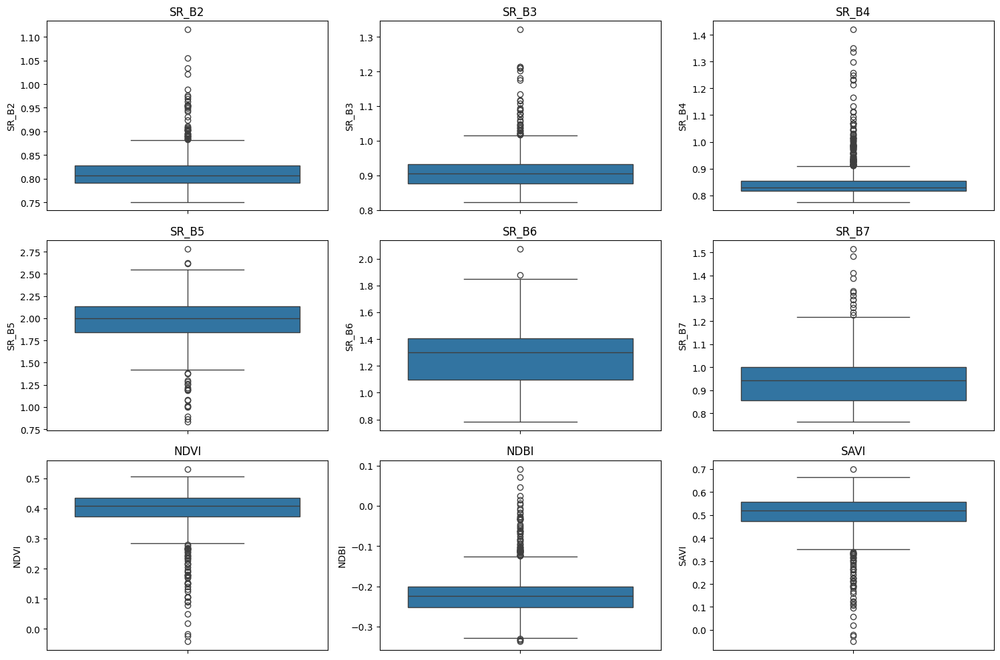

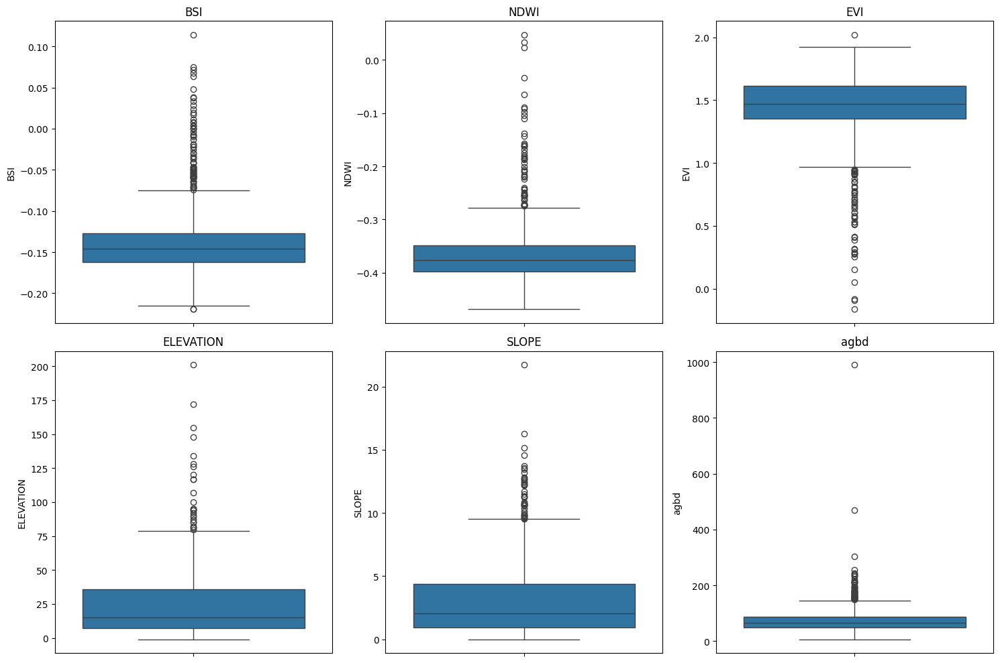

In [91]:
# prompt: check the distribution of data throuigh boxplot. each data in each subplot

# Create subplots for each variable
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(15, 10))

# Plot boxplots for each variable
sns.boxplot(y=sampled_data_df['SR_B2'], ax=axes[0, 0])
sns.boxplot(y=sampled_data_df['SR_B3'], ax=axes[0, 1])
sns.boxplot(y=sampled_data_df['SR_B4'], ax=axes[0, 2])
sns.boxplot(y=sampled_data_df['SR_B5'], ax=axes[1, 0])
sns.boxplot(y=sampled_data_df['SR_B6'], ax=axes[1, 1])
sns.boxplot(y=sampled_data_df['SR_B7'], ax=axes[1, 2])
sns.boxplot(y=sampled_data_df['NDVI'], ax=axes[2, 0])
sns.boxplot(y=sampled_data_df['NDBI'], ax=axes[2, 1])
sns.boxplot(y=sampled_data_df['SAVI'], ax=axes[2, 2])

# Set titles for each subplot
axes[0, 0].set_title('SR_B2')
axes[0, 1].set_title('SR_B3')
axes[0, 2].set_title('SR_B4')
axes[1, 0].set_title('SR_B5')
axes[1, 1].set_title('SR_B6')
axes[1, 2].set_title('SR_B7')
axes[2, 0].set_title('NDVI')
axes[2, 1].set_title('NDBI')
axes[2, 2].set_title('SAVI')

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

# Create subplots for the remaining variables
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(15, 10))

# Plot boxplots for the remaining variables
sns.boxplot(y=sampled_data_df['BSI'], ax=axes[0, 0])
sns.boxplot(y=sampled_data_df['NDWI'], ax=axes[0, 1])
sns.boxplot(y=sampled_data_df['EVI'], ax=axes[0, 2])
sns.boxplot(y=sampled_data_df['ELEVATION'], ax=axes[1, 0])
sns.boxplot(y=sampled_data_df['SLOPE'], ax=axes[1, 1])
sns.boxplot(y=sampled_data_df['agbd'], ax=axes[1, 2])

# Set titles for each subplot
axes[0, 0].set_title('BSI')
axes[0, 1].set_title('NDWI')
axes[0, 2].set_title('EVI')
axes[1, 0].set_title('ELEVATION')
axes[1, 1].set_title('SLOPE')
axes[1, 2].set_title('agbd')

# Adjust layout and display the plot
plt.tight_layout()
plt.show()


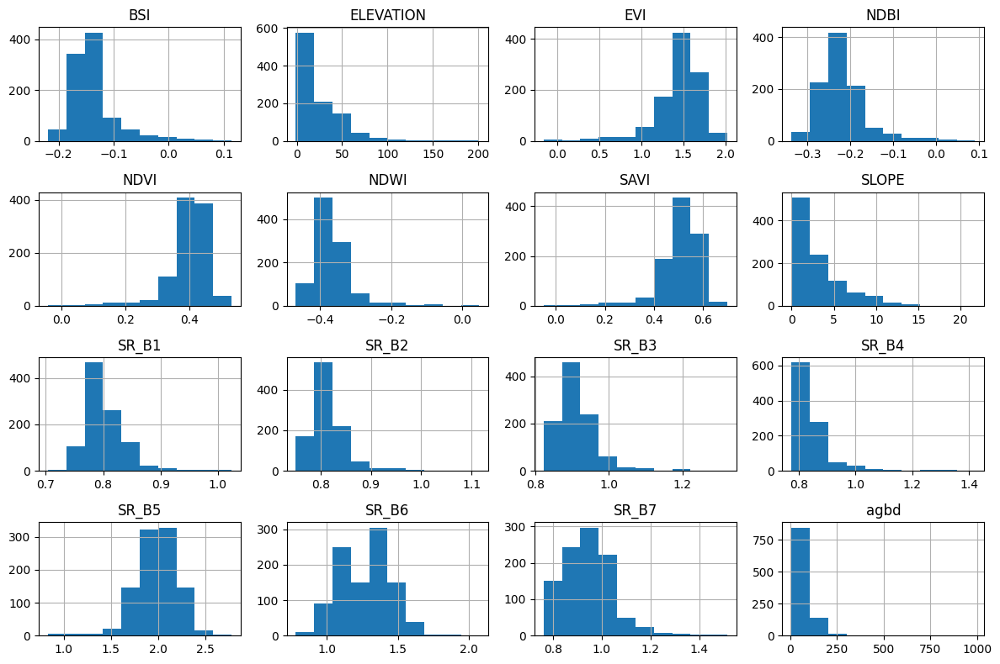

In [116]:
# Histograms for numerical features
sampled_data_df.hist(figsize=(12, 8))
plt.tight_layout()
plt.show()

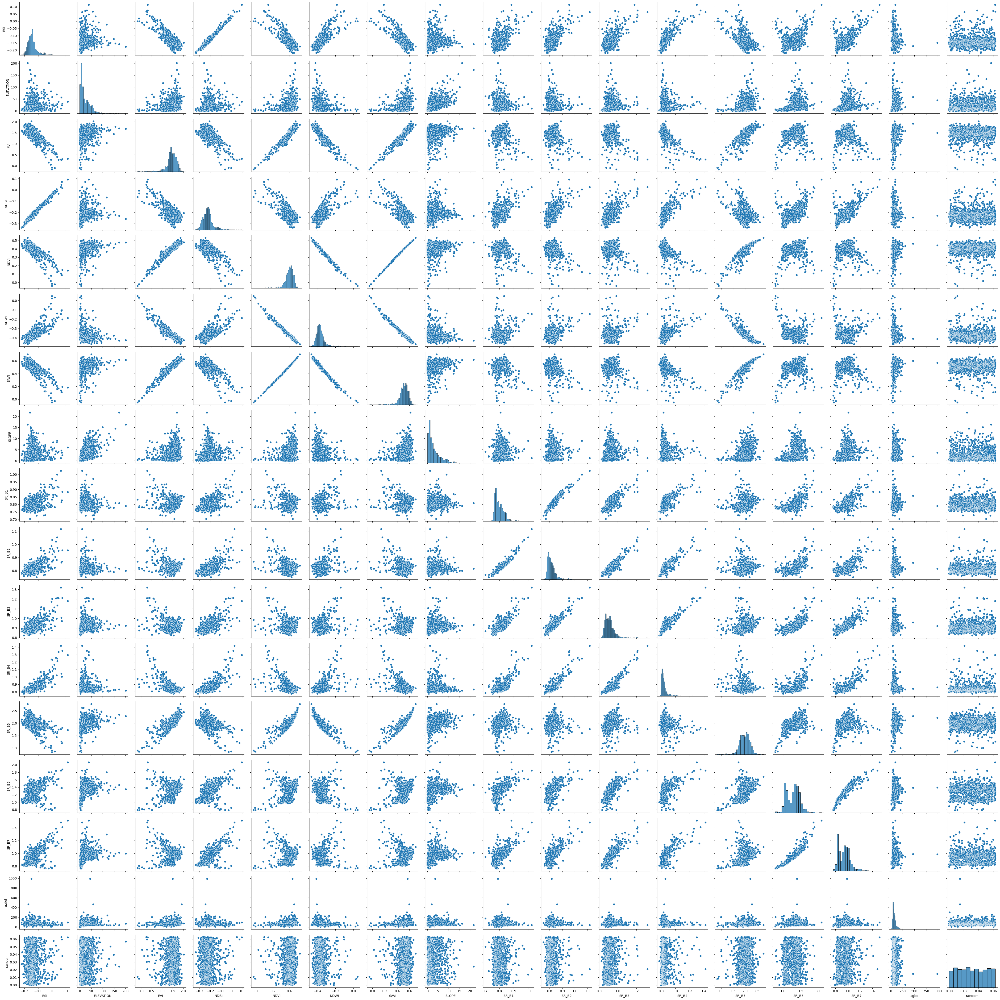

In [93]:
# Scatter plots for relationships between features
sns.pairplot(sampled_data_df)
plt.tight_layout()
plt.show()

In [117]:
# prompt: clean the outlier

# Calculate the IQR for each variable
Q1 = sampled_data_df.quantile(0.25)
Q3 = sampled_data_df.quantile(0.75)
IQR = Q3 - Q1

# Define the outlier boundaries
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filter the DataFrame to remove outliers
filtered_data_df = sampled_data_df[~((sampled_data_df < lower_bound) | (sampled_data_df > upper_bound)).any(axis=1)]

# Display the shape of the original and filtered DataFrames
print("Original DataFrame shape:", sampled_data_df.shape)
print("Filtered DataFrame shape:", filtered_data_df.shape)

# filtered_data_df = sampled_data_df

Original DataFrame shape: (1000, 16)
Filtered DataFrame shape: (772, 16)


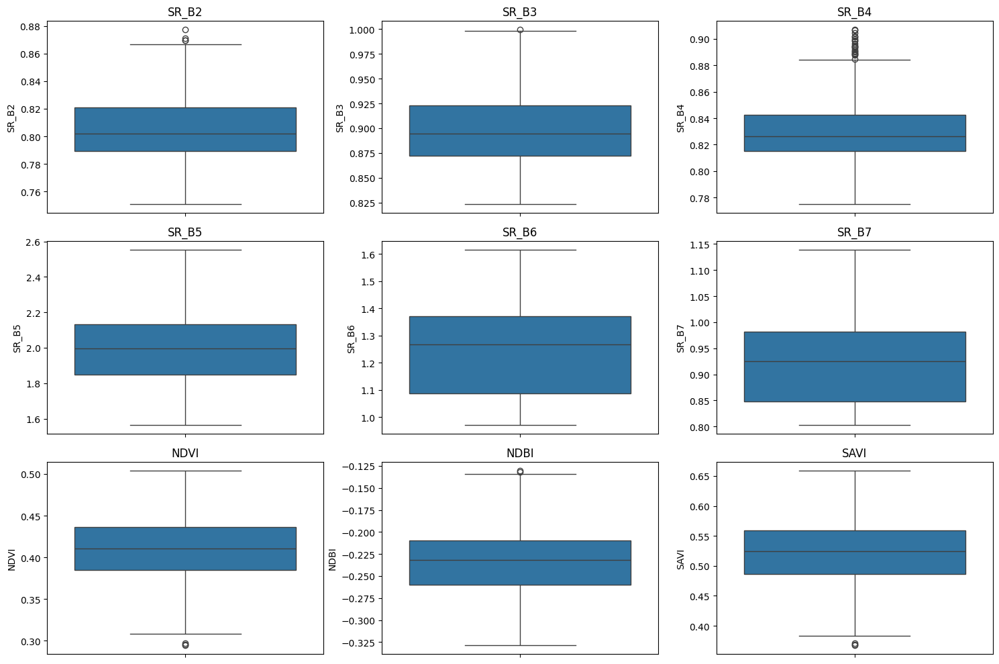

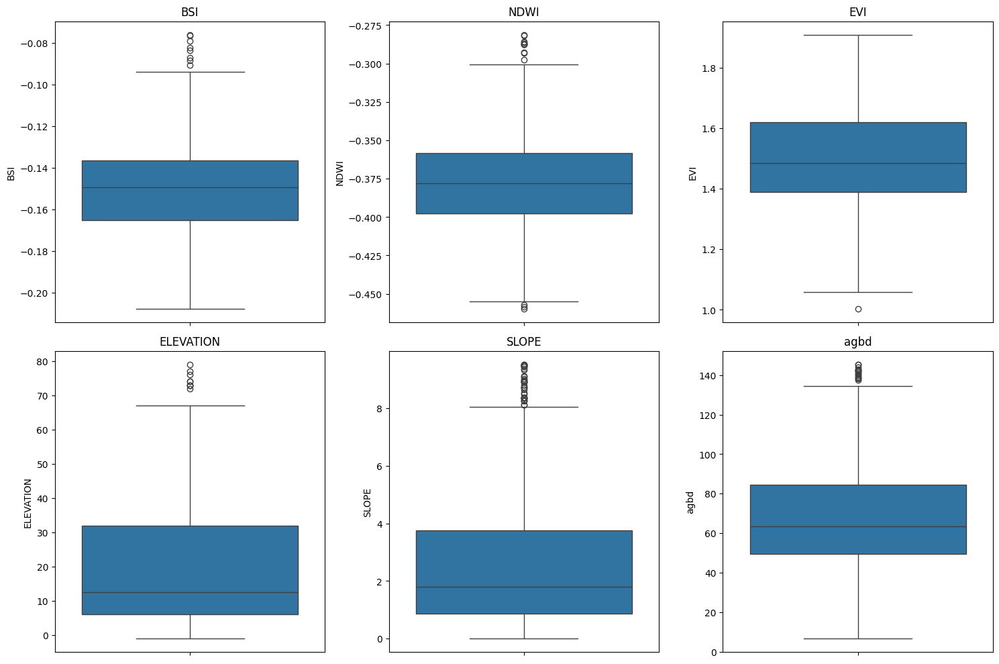

In [118]:
# prompt: show the boxplot for filtered data

# Create subplots for each variable
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(15, 10))

# Plot boxplots for each variable
sns.boxplot(y=filtered_data_df['SR_B2'], ax=axes[0, 0])
sns.boxplot(y=filtered_data_df['SR_B3'], ax=axes[0, 1])
sns.boxplot(y=filtered_data_df['SR_B4'], ax=axes[0, 2])
sns.boxplot(y=filtered_data_df['SR_B5'], ax=axes[1, 0])
sns.boxplot(y=filtered_data_df['SR_B6'], ax=axes[1, 1])
sns.boxplot(y=filtered_data_df['SR_B7'], ax=axes[1, 2])
sns.boxplot(y=filtered_data_df['NDVI'], ax=axes[2, 0])
sns.boxplot(y=filtered_data_df['NDBI'], ax=axes[2, 1])
sns.boxplot(y=filtered_data_df['SAVI'], ax=axes[2, 2])

# Set titles for each subplot
axes[0, 0].set_title('SR_B2')
axes[0, 1].set_title('SR_B3')
axes[0, 2].set_title('SR_B4')
axes[1, 0].set_title('SR_B5')
axes[1, 1].set_title('SR_B6')
axes[1, 2].set_title('SR_B7')
axes[2, 0].set_title('NDVI')
axes[2, 1].set_title('NDBI')
axes[2, 2].set_title('SAVI')

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

# Create subplots for the remaining variables
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(15, 10))

# Plot boxplots for the remaining variables
sns.boxplot(y=filtered_data_df['BSI'], ax=axes[0, 0])
sns.boxplot(y=filtered_data_df['NDWI'], ax=axes[0, 1])
sns.boxplot(y=filtered_data_df['EVI'], ax=axes[0, 2])
sns.boxplot(y=filtered_data_df['ELEVATION'], ax=axes[1, 0])
sns.boxplot(y=filtered_data_df['SLOPE'], ax=axes[1, 1])
sns.boxplot(y=filtered_data_df['agbd'], ax=axes[1, 2])

# Set titles for each subplot
axes[0, 0].set_title('BSI')
axes[0, 1].set_title('NDWI')
axes[0, 2].set_title('EVI')
axes[1, 0].set_title('ELEVATION')
axes[1, 1].set_title('SLOPE')
axes[1, 2].set_title('agbd')

# Adjust layout and display the plot
plt.tight_layout()
plt.show()


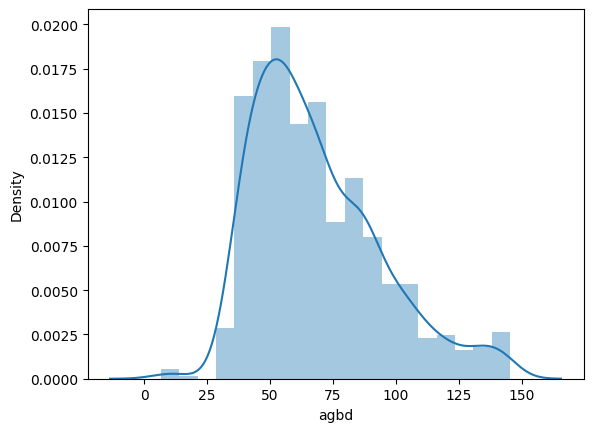

In [119]:
# Check the  distribution of labeled data
sns.distplot(filtered_data_df['agbd'])
plt.show()

In [97]:
# # Check the  distribution of labeled data
# sns.distplot(sampled_data_df['agbd'])
# plt.show()

In [120]:
# # It is right skewed. So, we need to do log transformation.

# filtered_data_df['agbd'] = np.log1p(filtered_data_df['agbd'])
# sns.distplot(filtered_data_df['agbd'])
# plt.show()

In [121]:
x = filtered_data_df.drop(['agbd',
                          #  'SLOPE',
                          #  'ELEVATION'
                           ],
                          axis=1)
y = filtered_data_df['agbd']

In [100]:
# # x = sampled_data_df.drop(['agbd'], axis=1)
# # y = sampled_data_df['agbd']

# x = sampled_data_df.drop(['agbd'], axis=1)[['EVI', 'NDVI', 'NDWI', 'SAVI', 'NDBI', 'BSI']]
# y = sampled_data_df['agbd']

In [123]:
# prompt: split the data into train and test

from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state=1234)


In [124]:
# prompt: Run Random Forest Model and all validation metrics

from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

# Initialize the Random Forest model
rf_model = RandomForestRegressor(random_state=42, n_estimators=500, min_samples_leaf=2)

# Fit the model to the training data
rf_model.fit(x_train, y_train)

# Predict on the test data
y_pred = rf_model.predict(x_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Print the evaluation metrics
print("Mean Squared Error:", mse)
print("Root Mean Squared Error:", rmse)
print("Mean Absolute Error:", mae)
print("R-squared:", r2)


Mean Squared Error: 676.1768129358153
Root Mean Squared Error: 26.00340002645453
Mean Absolute Error: 19.571400065197498
R-squared: -0.020371928857951138


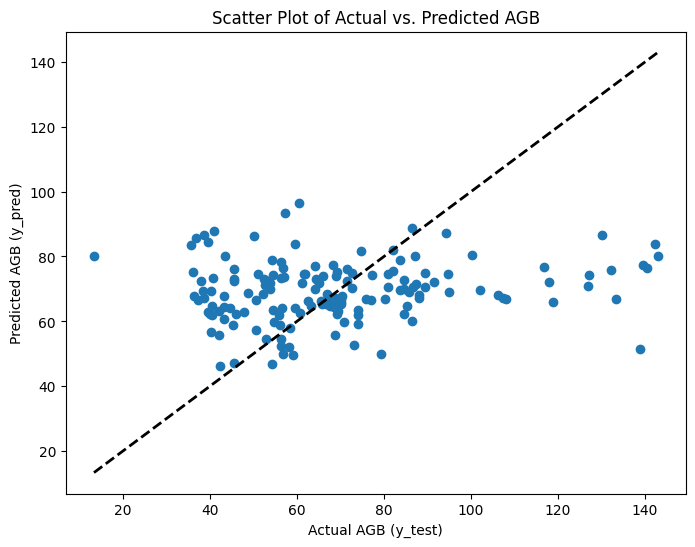

In [125]:
# prompt: Create a scatter plot for relationship between y pred and y test

plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred)
plt.xlabel("Actual AGB (y_test)")
plt.ylabel("Predicted AGB (y_pred)")
plt.title("Scatter Plot of Actual vs. Predicted AGB")
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)  # Add a diagonal line for reference
plt.show()

      feature  importance
1   ELEVATION    0.118195
7       SLOPE    0.104595
2         EVI    0.083770
5        NDWI    0.073730
10      SR_B3    0.071611
14      SR_B7    0.071336
11      SR_B4    0.068834
12      SR_B5    0.062478
8       SR_B1    0.060934
0         BSI    0.058768
13      SR_B6    0.052615
9       SR_B2    0.050106
3        NDBI    0.044892
6        SAVI    0.039301
4        NDVI    0.038835


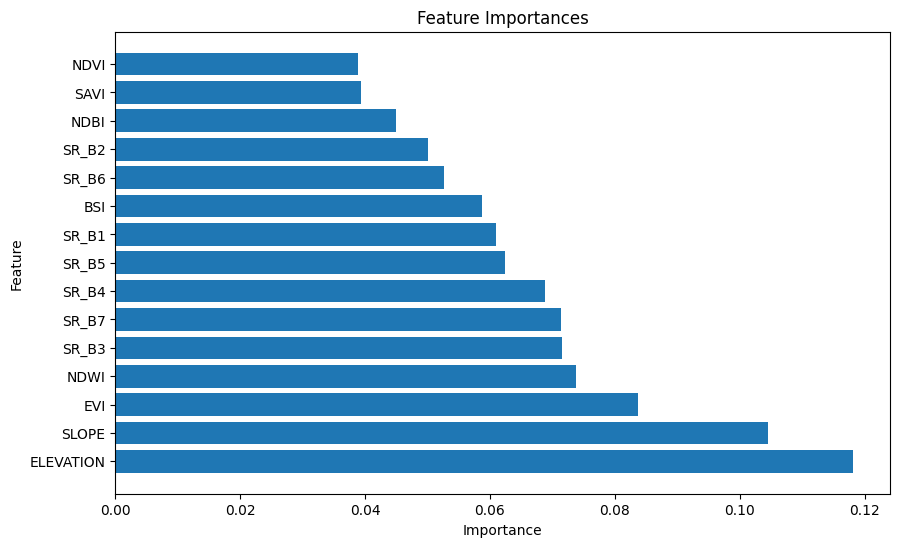

In [126]:
# prompt: Asses the feature importance

# Get feature importances from the trained Random Forest model
importances = rf_model.feature_importances_

# Create a DataFrame to store feature names and their importances
feature_importances = pd.DataFrame({'feature': x_train.columns, 'importance': importances})

# Sort the features by importance in descending order
feature_importances = feature_importances.sort_values('importance', ascending=False)

# Print or display the feature importances
print(feature_importances)

# Visualize feature importances using a bar plot
plt.figure(figsize=(10, 6))
plt.barh(feature_importances['feature'], feature_importances['importance'])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Feature Importances')
plt.show()

## Rest of further RF

In [33]:
# prompt: I got high error and low  r2, please do a hyperparameter tunning and if its possible also do a feature engineering

from sklearn.model_selection import GridSearchCV

# Define the hyperparameter grid to search
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Initialize GridSearchCV
grid_search = GridSearchCV(estimator=rf_model, param_grid=param_grid, cv=5, scoring='neg_mean_squared_error')

# Fit the grid search to the training data
grid_search.fit(x_train, y_train)

# Get the best hyperparameters
best_params = grid_search.best_params_
print("Best Hyperparameters:", best_params)

# Initialize a new Random Forest model with the best hyperparameters
best_rf_model = RandomForestRegressor(**best_params, random_state=42)

# Fit the best model to the training data
best_rf_model.fit(x_train, y_train)

# Predict on the test data
y_pred_best = best_rf_model.predict(x_test)

# Evaluate the best model
mse_best = mean_squared_error(y_test, y_pred_best)
rmse_best = np.sqrt(mse_best)
mae_best = mean_absolute_error(y_test, y_pred_best)
r2_best = r2_score(y_test, y_pred_best)

# Print the evaluation metrics for the best model
print("Mean Squared Error (Best Model):", mse_best)
print("Root Mean Squared Error (Best Model):", rmse_best)
print("Mean Absolute Error (Best Model):", mae_best)
print("R-squared (Best Model):", r2_best)

# Feature Engineering (example - adding interaction terms)
x_train_engineered = x_train.copy()
x_test_engineered = x_test.copy()
# Fit the best model with engineered features
best_rf_model.fit(x_train_engineered, y_train)

# Predict on the test data with engineered features
y_pred_engineered = best_rf_model.predict(x_test_engineered)

# Evaluate the model with engineered features
mse_engineered = mean_squared_error(y_test, y_pred_engineered)
rmse_engineered = np.sqrt(mse_engineered)
mae_engineered = mean_absolute_error(y_test, y_pred_engineered)
r2_engineered = r2_score(y_test, y_pred_engineered)

# Print the evaluation metrics for the model with engineered features
print("Mean Squared Error (Engineered Features):", mse_engineered)
print("Root Mean Squared Error (Engineered Features):", rmse_engineered)
print("Mean Absolute Error (Engineered Features):", mae_engineered)
print("R-squared (Engineered Features):", r2_engineered)

In [ ]:
# prompt: Visualize the relation between predicted and observed AGB

# Visualize the relation between predicted and observed AGB
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.7)
plt.xlabel("Observed AGB")
plt.ylabel("Predicted AGB")
plt.title("Observed vs. Predicted AGB")
plt.show()


In [ ]:
# # prompt: Run Random Fores Model with Cross Validation and Randomized Search CV

# import numpy as np
# from sklearn.ensemble import RandomForestRegressor
# from sklearn.model_selection import RandomizedSearchCV, cross_val_score

# # Define the parameter grid for randomized search
# param_dist = {
#     'n_estimators': np.arange(50, 501, 50),
#     'max_depth': [None] + list(np.arange(5, 51, 5)),
#     'min_samples_split': np.arange(2, 11),
#     'min_samples_leaf': np.arange(1, 5),
#     'max_features': ['auto', 'sqrt', 'log2']
# }

# # Create a Random Forest Regressor model
# rf_model = RandomForestRegressor(random_state=42)

# # Perform Randomized Search CV with cross-validation
# random_search = RandomizedSearchCV(
#     estimator=rf_model,
#     param_distributions=param_dist,
#     n_iter=100,  # Number of random combinations to try
#     cv=5,  # Number of cross-validation folds
#     scoring='neg_mean_squared_error',  # Use negative MSE for scoring
#     n_jobs=-1,  # Use all available cores
#     verbose=2,
#     random_state=42
# )

# # Fit the randomized search to the training data
# random_search.fit(x_train, y_train)

# # Get the best model from the randomized search
# best_rf_model = random_search.best_estimator_

# # Perform cross-validation on the best model
# cv_scores = cross_val_score(
#     best_rf_model, x_train, y_train, cv=5, scoring='neg_mean_squared_error'
# )

# # Calculate the mean and standard deviation of the cross-validation scores
# mean_cv_rmse = np.sqrt(-cv_scores.mean())
# std_cv_rmse = np.sqrt(cv_scores.std())

# print("Cross-Validation RMSE (Mean):", mean_cv_rmse)
# print("Cross-Validation RMSE (Standard Deviation):", std_cv_rmse)


In [ ]:
# prompt: Do this validation metrices as well: MSE
# RMSE
# R-squaredMAE

from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Predict on the test set
y_pred = best_rf_model.predict(x_test)

# Calculate validation metrics
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

# Print the validation metrics
print("Mean Squared Error (MSE):", mse)
print("Root Mean Squared Error (RMSE):", rmse)
print("R-squared:", r2)
print("Mean Absolute Error (MAE):", mae)


In [ ]:
# prompt: visualize it

# Visualize predictions vs actual values
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.7)
plt.xlabel("Actual AGB")
plt.ylabel("Predicted AGB")
plt.title("Actual vs Predicted AGB")
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], linestyle='--', color='red')  # Add a diagonal line for reference
plt.grid(True)
plt.show()

# Residual plot
residuals = y_test - y_pred
plt.figure(figsize=(8, 6))
plt.scatter(y_pred, residuals, alpha=0.7)
plt.xlabel("Predicted AGB")
plt.ylabel("Residuals")
plt.title("Residual Plot")
plt.axhline(y=0, color='red', linestyle='--')  # Add a horizontal line at zero
plt.grid(True)
plt.show()

# Feature importance
feature_importances = best_rf_model.feature_importances_
feature_names = x_train.columns
importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importances})
importance_df = importance_df.sort_values('Importance', ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df)
plt.title("Feature Importance")
plt.show()


In [ ]:
# prompt: Visualize Validation, show the r2 as well. make a dedicated chart

# ... (preceding code)

# Evaluate the model on the test set
y_pred = best_rf_model.predict(x_test)
test_rmse = np.sqrt(mean_squared_error(y_test, y_pred))

# Calculate R-squared
from sklearn.metrics import r2_score
r2 = r2_score(y_test, y_pred)

# Create a scatter plot with a regression line
plt.figure(figsize=(8, 6))
sns.regplot(x=y_test, y=y_pred, scatter_kws={'alpha':0.6})
plt.xlabel('Observed AGB')
plt.ylabel('Predicted AGB')
plt.title('Validation Results (R-squared: {:.6f})'.format(r2))

# Display the plot
plt.show()


In [ ]:
# !pip install --upgrade dtreeviz
# Upgrade dtreeviz to the latest version

import dtreeviz
from dtreeviz.trees import *

viz = dtreeviz.model(best_rf_model.estimators_[0],
               x_train,
               y_train,
               target_name='agbd',
               feature_names=x_train.columns
              )


viz.view()
# Use dtreeviz.trees.dtreeviz instead of dtreeviz.model

In [ ]:
y_test.describe()

##Gradient Boosting

In [131]:
x = sampled_data_df.drop(['agbd'], axis=1)
y = sampled_data_df['agbd']

In [132]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state=1234)

In [134]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
import numpy as np

# Initialize the Gradient Boosting model
gb_model = GradientBoostingRegressor(random_state=1234, n_estimators=500, learning_rate=0.1, max_depth=3)

# Fit the model to the training data
gb_model.fit(x_train, y_train)

# Predict on the test data
y_pred = gb_model.predict(x_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Print the evaluation metrics
print("Mean Squared Error:", mse)
print("Root Mean Squared Error:", rmse)
print("Mean Absolute Error:", mae)
print("R-squared:", r2)

Mean Squared Error: 1680.1606246132555
Root Mean Squared Error: 40.98976243665307
Mean Absolute Error: 29.37108935242518
R-squared: -0.32403630479598045


In [135]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
import numpy as np

# Initialize the scaler
scaler = StandardScaler()

# Fit and transform the training data, then transform the test data
x_train_scaled = scaler.fit_transform(x_train)
x_test_scaled = scaler.transform(x_test)

# Initialize the Gradient Boosting model
gb_model = GradientBoostingRegressor(random_state=42, n_estimators=500, learning_rate=0.1, max_depth=3)

# Fit the model to the scaled training data
gb_model.fit(x_train_scaled, y_train)

# Predict on the scaled test data
y_pred = gb_model.predict(x_test_scaled)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Print the evaluation metrics
print("Mean Squared Error:", mse)
print("Root Mean Squared Error:", rmse)
print("Mean Absolute Error:", mae)
print("R-squared:", r2)


Mean Squared Error: 1625.5639149951028
Root Mean Squared Error: 40.31828263945654
Mean Absolute Error: 29.602509778835866
R-squared: -0.2810118316605754


#2ND TRIAL

In [136]:
import os
# mount google drive
from google.colab import drive
drive.mount('/content/drive')

loc = '/content/drive/MyDrive/Portfolio/Mangrove AGB Modeling/'
# create a path if it doesn't exist
if not os.path.exists(loc):
    os.makedirs(loc)
os.chdir(loc)
print('Working Directory: ',os.getcwd())

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Working Directory:  /content/drive/MyDrive/Portfolio/Mangrove AGB Modeling


In [137]:
import ee
import geemap

# Initialize the Earth Engine library.
ee.Authenticate()
ee.Initialize(project='ee-rizkiatthoriq99-9')

In [140]:
m = geemap.Map()
m

Map(center=[0, 0], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=SearchDataGUI(childr…

In [141]:
m.user_roi.getInfo()

{'geodesic': False,
 'type': 'Polygon',
 'coordinates': [[[117.287289, -0.699331],
   [117.287289, -0.539695],
   [117.579374, -0.539695],
   [117.579374, -0.699331],
   [117.287289, -0.699331]]]}

In [212]:
# Define the coordinates of the box
# coords = [[[117.287289, -0.699331],
#    [117.287289, -0.539695],
#    [117.579374, -0.539695],
#    [117.579374, -0.699331],
#    [117.287289, -0.699331]]]

coords = [
    [116.973725, -0.999705],
    [116.973725, -0.258178],
    [117.780991, -0.258178],
    [117.780991, -0.999705],
    [116.973725, -0.999705]  # Close the polygon
]


# Create a geometry object from the coordinates
box = ee.Geometry.Polygon(coords, None, False)

# Add the box to the map (optional)
m.addLayer(box, {}, 'Box')

# Center the map on the box
m.centerObject(box, 10)  # Adjust the zoom level as needed

m


Map(bottom=1053604.0, center=[-0.6289379235133751, 117.37735799999996], controls=(WidgetControl(options=['posi…

In [144]:
m

Map(bottom=263369.0, center=[-0.6351340866498045, 117.47013578329629], controls=(WidgetControl(options=['posit…

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [213]:
startDate = '2023-01-01'
endDate = '2023-12-31'

In [214]:
# Function to mask clouds using the Sentinel-2 QA band.
# function maskS2clouds(image) {
def maskS2clouds(image):
  qa = image.select('QA60')

  # Bits 10 and 11 are clouds and cirrus, respectively.
  cloudBitMask = 1 << 10
  cirrusBitMask = 1 << 11

  # Both flags should be set to zero, indicating clear conditions.
  mask = qa.bitwiseAnd(cloudBitMask).eq(0).And(
             qa.bitwiseAnd(cirrusBitMask).eq(0))

  # Return the masked and scaled data, without the QA bands.
  return image.updateMask(mask).divide(10000) \
      .select("B.*") \
      .copyProperties(image, ["system:time_start"])
# }

# Map the function over one year of data and take the median.
# Load Sentinel-2 TOA reflectance data.
collection = ee.ImageCollection('COPERNICUS/S2') \
    .filterDate(startDate, endDate) \
    .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 10)) \
    .map(maskS2clouds)

composite = collection.median().clip(box)

# Display the results.
m.addLayer(composite, {'bands': ['B4', 'B3', 'B2'], 'min': 0, 'max': 0.3}, 'RGB')
m

Map(bottom=131830.0, center=[-0.6289379235133751, 117.37735799999996], controls=(WidgetControl(options=['posit…

In [191]:
# prompt: calculate spectral indices (at least 6: ndvi, ndbi, savi, bsi, ndwi) , add all to bands and visualize

# Calculate NDVI
ndvi = composite.normalizedDifference(['B8', 'B4']).rename('NDVI')

# Calculate NDBI
ndbi = composite.normalizedDifference(['B11', 'B8']).rename('NDBI')

# Calculate SAVI
savi = composite.expression(
    '(1 + L) * float(NIR - RED) / (NIR + RED + L)', {
        'NIR': composite.select('B8'),
        'RED': composite.select('B4'),
        'L': 0.5  # Soil adjustment factor
    }).rename('SAVI')

# Calculate BSI
bsi = composite.expression(
    '(NIR + RED) / (NIR - RED)', {
        'NIR': composite.select('B8'),
        'RED': composite.select('B4')
    }).rename('BSI')

# Calculate NDWI
ndwi = composite.normalizedDifference(['B3', 'B8']).rename('NDWI')

# Calculate EVI
evi = composite.expression(
    '2.5 * ((NIR - RED) / (NIR + 6 * RED - 7.5 * BLUE + 1))', {
        'NIR': composite.select('B8'),
        'RED': composite.select('B4'),
        'BLUE': composite.select('B2')
    }).rename('EVI')

# Add all indices to the composite image
composite = composite.addBands([ndvi, ndbi, savi, bsi, ndwi, evi])

# Visualize NDVI
m.addLayer(ndvi, {'min': -1, 'max': 1, 'palette': ['blue', 'white', 'green']}, 'NDVI')

# Visualize NDBI
m.addLayer(ndbi, {'min': -1, 'max': 1, 'palette': ['brown', 'white', 'blue']}, 'NDBI')

# Visualize SAVI
m.addLayer(savi, {'min': -1, 'max': 1, 'palette': ['blue', 'white', 'green']}, 'SAVI')

# Visualize BSI
m.addLayer(bsi, {'min': -1, 'max': 1, 'palette': ['brown', 'white', 'green']}, 'BSI')

# Visualize NDWI
m.addLayer(ndwi, {'min': -1, 'max': 1, 'palette': ['blue', 'white', 'green']}, 'NDWI')

# Visualize EVI
m.addLayer(evi, {'min': -1, 'max': 1, 'palette': ['blue', 'white', 'green']}, 'EVI')

m

Map(bottom=263500.0, center=[-0.7247350067573822, 117.39104533222974], controls=(WidgetControl(options=['posit…

In [192]:
# Import the ALOS AW3D30 digital elevation model.
elevation = ee.Image("CGIAR/SRTM90_V4").select('elevation').clip(box)

# Calculate slope from the elevation data.
slope = ee.Terrain.slope(elevation)

# Add elevation and slope to the image
composite = composite.addBands(elevation.rename('ELEVATION')).addBands(slope.rename('SLOPE'))

# Visualize elevation
m.addLayer(elevation, {'min': 0, 'max': 100, 'palette': ['#333399', '#00cc66', '#ffff99', '#805c54', '#ffffff']}, 'Elevation')
m


Map(bottom=1052596.0, center=[-0.6385671021092082, 117.40924872906413], controls=(WidgetControl(options=['posi…

In [193]:
# Function to select highest quality GEDI data
def func_zzt(image):
    # Use 'l2b_quality_flag' instead of 'l4_quality_flag'
    return image.updateMask(image.select('l2_quality_flag').eq(1)) \
    .updateMask(image.select('degrade_flag').eq(0))

qualityMask = func_zzt


# Function to mask unreliable GEDI measurements
# with a relative standard error > 50%
# agbd_se / agbd > 0.5
def func_wol(image):
    relative_se = image.select('agbd_se') \
    .divide(image.select('agbd'))
    return image.updateMask(relative_se.lte(0.5))

errorMask = func_wol

# Function to mask slope
def fun_slp(image):
    return image.updateMask(l8_with_indices.select('SLOPE').lt(30))

slopeMask = fun_slp


In [194]:
gedi = ee.ImageCollection("LARSE/GEDI/GEDI04_A_002_MONTHLY") \
          .filterDate('2022-01-01', '2022-12-31') \
          .map(qualityMask) \
          .map(errorMask) \
          .map(slopeMask) \
          .select('agbd') \
          .median() \
          .clip(box)

m.addLayer(gedi, {'min': 0, 'max': 100}, 'GEDI AGB')
m

Map(bottom=263374.0, center=[-0.6382238006662402, 117.69310299634792], controls=(WidgetControl(options=['posit…

In [195]:
# Convert GEDI image to points
gedi_points = gedi.sample(**{
    'region':box,
    'geometries':True,
    'scale':25,  # Adjust the scale as needed
})

# Add GEDI points to the map
m.addLayer(gedi_points, {'color': 'yellow'}, 'GEDI Points')
m


Map(bottom=263374.0, center=[-0.6382238006662402, 117.69310299634792], controls=(WidgetControl(options=['posit…

In [196]:
random_gedi_points = gedi_points.randomColumn('random',seed=42).sort('random').limit(1000)

# Add random points to the map
m.addLayer(random_gedi_points, {'color': 'red'}, 'Random GEDI Points')
m

# random_gedi_points = gedi_points

Map(bottom=263374.0, center=[-0.6382238006662402, 117.69310299634792], controls=(WidgetControl(options=['posit…

In [197]:
# prompt: sample the composite with fgedi points to get the pixel values of bands

# Sample the Landsat image at the GEDI point locations
sampled_data = composite.sampleRegions(
    collection=random_gedi_points,
    geometries=True,
    scale=25
)


In [198]:
sampled_data

In [199]:
sampled_data_df = geemap.ee_to_df(sampled_data).drop('random', axis=1)
sampled_data_df.head()

,B1,B10,B11,B12,B2,B3,B4,B5,B6,B7,...,B9,BSI,ELEVATION,EVI,NDBI,NDVI,NDWI,SAVI,SLOPE,agbd
0,0.2121,0.1009,0.1878,0.1260,0.1811,0.1656,0.1399,0.1613,0.2747,0.3542,...,0.1230,2.440783,7,0.595523,-0.280322,0.409705,-0.337202,0.299076,1.664513,80.784332
1,0.2132,0.1006,0.1752,0.1243,0.1859,0.1749,0.1464,0.1724,0.2745,0.3158,...,0.1206,2.974376,5,0.476022,-0.254309,0.336205,-0.255111,0.236372,1.545443,50.611240
2,0.2155,0.1012,0.2552,0.1539,0.1823,0.1761,0.1403,0.1760,0.3191,0.4008,...,0.1237,2.184466,15,0.695333,-0.192916,0.457778,-0.363456,0.349238,3.600732,89.875771
3,0.2130,0.1009,0.2139,0.1375,0.1814,0.1732,0.1400,0.1718,0.2894,0.3616,...,0.1244,2.363858,13,0.622272,-0.234979,0.423037,-0.331919,0.312544,1.114615,36.314934
4,0.2142,0.1012,0.3068,0.1751,0.1839,0.1769,0.1411,0.1811,0.3823,0.4816,...,0.1326,1.871526,51,0.868329,-0.204872,0.534323,-0.448738,0.439150,6.530219,184.072968


In [200]:
list(sampled_data_df.columns)

['B1',
 'B10',
 'B11',
 'B12',
 'B2',
 'B3',
 'B4',
 'B5',
 'B6',
 'B7',
 'B8',
 'B8A',
 'B9',
 'BSI',
 'ELEVATION',
 'EVI',
 'NDBI',
 'NDVI',
 'NDWI',
 'SAVI',
 'SLOPE',
 'agbd']

In [201]:
sampled_data_df

,B1,B10,B11,B12,B2,B3,B4,B5,B6,B7,...,B9,BSI,ELEVATION,EVI,NDBI,NDVI,NDWI,SAVI,SLOPE,agbd
0,0.2121,0.1009,0.1878,0.1260,0.1811,0.1656,0.1399,0.1613,0.2747,0.3542,...,0.1230,2.440783,7,0.595523,-0.280322,0.409705,-0.337202,0.299076,1.664513,80.784332
1,0.2132,0.1006,0.1752,0.1243,0.1859,0.1749,0.1464,0.1724,0.2745,0.3158,...,0.1206,2.974376,5,0.476022,-0.254309,0.336205,-0.255111,0.236372,1.545443,50.611240
2,0.2155,0.1012,0.2552,0.1539,0.1823,0.1761,0.1403,0.1760,0.3191,0.4008,...,0.1237,2.184466,15,0.695333,-0.192916,0.457778,-0.363456,0.349238,3.600732,89.875771
3,0.2130,0.1009,0.2139,0.1375,0.1814,0.1732,0.1400,0.1718,0.2894,0.3616,...,0.1244,2.363858,13,0.622272,-0.234979,0.423037,-0.331919,0.312544,1.114615,36.314934
4,0.2142,0.1012,0.3068,0.1751,0.1839,0.1769,0.1411,0.1811,0.3823,0.4816,...,0.1326,1.871526,51,0.868329,-0.204872,0.534323,-0.448738,0.439150,6.530219,184.072968
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
990,0.2226,0.1011,0.2044,0.1355,0.1972,0.1841,0.1564,0.1785,0.3067,0.3944,...,0.1281,2.448148,1,0.649195,-0.291262,0.408472,-0.338365,0.314930,1.114581,95.925880
991,0.2120,0.1007,0.1852,0.1253,0.1812,0.1714,0.1405,0.1682,0.2885,0.3653,...,0.1206,2.395233,2,0.609638,-0.297287,0.417496,-0.332164,0.307512,1.879897,42.484562
992,0.2131,0.1005,0.1769,0.1180,0.1799,0.1714,0.1355,0.1699,0.3458,0.4489,...,0.1194,2.019180,1,0.768364,-0.388207,0.495251,-0.401536,0.384656,0.000000,133.557159
993,0.2139,0.1009,0.2232,0.1381,0.1828,0.1788,0.1418,0.1829,0.3726,0.4635,...,0.1296,1.920182,5,0.828673,-0.336898,0.520784,-0.431298,0.423429,0.618303,38.793907


In [202]:
x = sampled_data_df.drop(['agbd'], axis=1)
y = sampled_data_df['agbd']

In [203]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state=1234)

In [204]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
import numpy as np

# Initialize the Gradient Boosting model
gb_model = GradientBoostingRegressor(random_state=1234, n_estimators=500, learning_rate=0.1, max_depth=3)

# Fit the model to the training data
gb_model.fit(x_train, y_train)

# Predict on the test data
y_pred = gb_model.predict(x_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Print the evaluation metrics
print("Mean Squared Error:", mse)
print("Root Mean Squared Error:", rmse)
print("Mean Absolute Error:", mae)
print("R-squared:", r2)

Mean Squared Error: 705.9773729534542
Root Mean Squared Error: 26.570234717695932
Mean Absolute Error: 20.290359854355227
R-squared: 0.056977042411512135


Mean Squared Error: 620.7817366863467
Root Mean Squared Error: 24.91549190135219
Mean Absolute Error: 19.028260387095607
R-squared: 0.17077876462554364


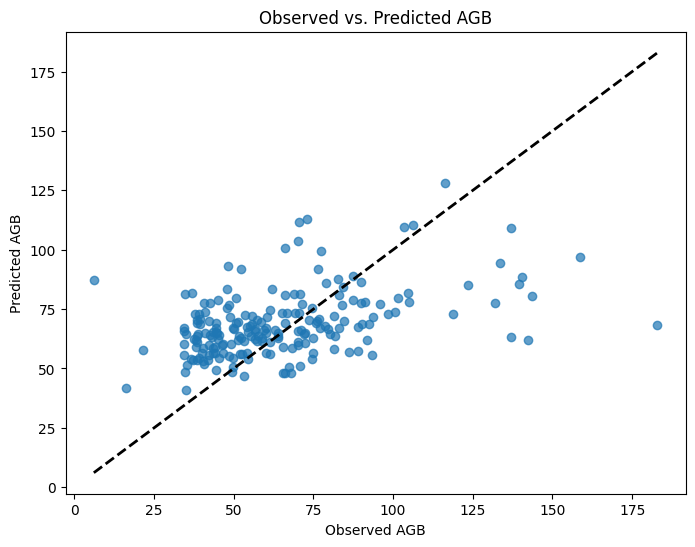

In [207]:
# prompt: the resuylt is bad:
# Mean Squared Error: 705.9773729534542
# Root Mean Squared Error: 26.570234717695932
# Mean Absolute Error: 20.290359854355227
# R-squared: 0.056977042411512135

# ... (preceding code)

# Initialize the Random Forest model
rf_model = RandomForestRegressor(random_state=42)

# Fit the model to the training data
rf_model.fit(x_train, y_train)

# Predict on the test data
y_pred = rf_model.predict(x_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Print the evaluation metrics
print("Mean Squared Error:", mse)
print("Root Mean Squared Error:", rmse)
print("Mean Absolute Error:", mae)
print("R-squared:", r2)


# Visualize the relation between predicted and observed AGB
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.7)
plt.xlabel("Observed AGB")
plt.ylabel("Predicted AGB")
plt.title("Observed vs. Predicted AGB")
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)  # Add a diagonal line for reference
plt.show()



# ... (rest of your code)

Mean Squared Error: 31.822920849663095
Root Mean Squared Error: 5.641180802780841
Mean Absolute Error: 2.4579848301845324
R-squared: 0.9574919167547709


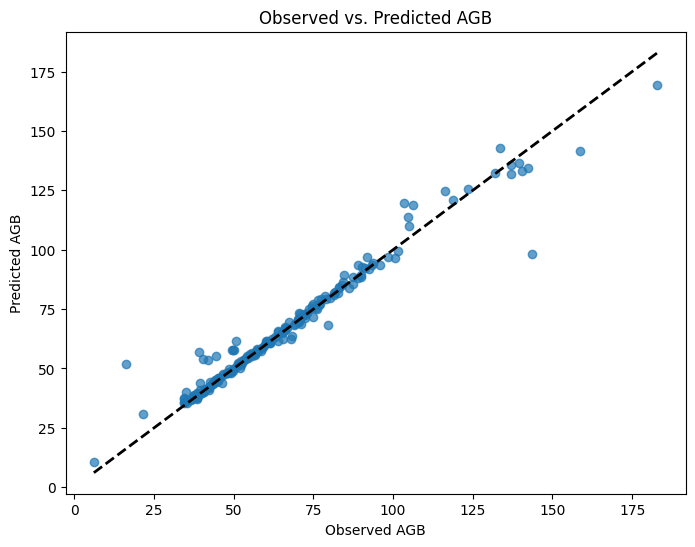

In [210]:
# prompt: Still bad result, please do the feature engineering maybe 5 vareiations , also engineer the fature with y data (agbd)  of the varaibels and do the standardization fot x and y,  and model the data

# Feature Engineering
x_train_engineered = x_train.copy()
x_test_engineered = x_test.copy()

# 1. Interaction terms: Multiply relevant features together
x_train_engineered['NDVI_EVI'] = x_train['NDVI'] * x_train['EVI']
x_test_engineered['NDVI_EVI'] = x_test['NDVI'] * x_test['EVI']

# 2. Polynomial features: Add squared terms of important features
x_train_engineered['NDVI_sq'] = x_train['NDVI'] ** 2
x_test_engineered['NDVI_sq'] = x_test['NDVI'] ** 2

# 3. Ratio of features: Create ratios between relevant features
x_train_engineered['NDVI_NDBI_ratio'] = x_train['NDVI'] / (x_train['NDBI'] + 1e-6)  # Add small value to avoid division by zero
x_test_engineered['NDVI_NDBI_ratio'] = x_test['NDVI'] / (x_test['NDBI'] + 1e-6)

# 4. Logarithmic transformation: Apply log transformation to features with skewed distributions
x_train_engineered['log_B8'] = np.log(x_train['B8'] + 1) # Add 1 to handle potential zero values
x_test_engineered['log_B8'] = np.log(x_test['B8'] + 1)

# 5. Feature interaction with Y (AGB)
x_train_engineered['NDVI_agbd_interaction'] = x_train['NDVI'] * y_train
x_test_engineered['NDVI_agbd_interaction'] = x_test['NDVI'] * y_test


# Standardization for X and Y
scaler_x = StandardScaler()
scaler_y = StandardScaler()

x_train_scaled = scaler_x.fit_transform(x_train_engineered)
x_test_scaled = scaler_x.transform(x_test_engineered)

y_train_scaled = scaler_y.fit_transform(np.array(y_train).reshape(-1, 1))
y_test_scaled = scaler_y.transform(np.array(y_test).reshape(-1, 1))


# # Initialize the Random Forest model
rf_model = RandomForestRegressor(random_state=42)


# Fit the model to the scaled training data
rf_model.fit(x_train_scaled, y_train_scaled.ravel())

# Predict on the scaled test data
y_pred_scaled = rf_model.predict(x_test_scaled)


# Inverse transform the predicted AGB to original scale
y_pred = scaler_y.inverse_transform(y_pred_scaled.reshape(-1, 1))

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)


# Print the evaluation metrics
print("Mean Squared Error:", mse)
print("Root Mean Squared Error:", rmse)
print("Mean Absolute Error:", mae)
print("R-squared:", r2)


# Visualize the relation between predicted and observed AGB
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.7)
plt.xlabel("Observed AGB")
plt.ylabel("Predicted AGB")
plt.title("Observed vs. Predicted AGB")
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)  # Add a diagonal line for reference
plt.show()